In [1]:
#%load_ext pycodestyle_magic
#%pycodestyle_on

# 1. Chargement du nouveau fichier

> Création du dataFrame **data_df** à partir du fichier **olist_new.csv**

In [252]:
import numpy as np
import pandas as pd
from pandas import DataFrame
from matplotlib import pyplot as plt
from sklearn.cluster import KMeans
from sklearn import linear_model
from sklearn import decomposition
from sklearn import preprocessing
from ipywidgets import interact
from ipywidgets import interactive
from IPython.display import display
import ipywidgets as widgets
from functions import *
import seaborn as sns
import missingno as msno
import warnings

warnings.filterwarnings('ignore')

sns.set()

missing_values = ["na", "n/a", "--", " "]
data_df = pd.read_csv("olist_new.csv",
                      sep=',', na_values=missing_values,
                      low_memory=False)

data_order_payments = pd.read_csv("olist_order_payments_dataset.csv",
                                  sep=',', na_values=missing_values,
                                  low_memory=False)
data_orders = pd.read_csv("olist_orders_dataset.csv",
                          sep=',', na_values=missing_values,
                          low_memory=False)

data_fusion = pd.read_csv("olist_fusion.csv",
                      sep=',', na_values=missing_values,
                      low_memory=False)

## a) Affichage des lignes en début de fichier

> Il doit contenir uniquement des données numériques afin d'appliquer la réduction de dimension et le clustering.

In [215]:
data_df.dtypes.value_counts()

float64    250
dtype: int64

In [216]:
data_df.head()

,order_purchase_year,order_purchase_month,order_purchase_hour,order_purchase_day,order_item_id,price,freight_value,payment_sequential,payment_installments,payment_value,...,review_answer_time_day_Afternoon,review_answer_time_day_Morning,review_answer_time_day_Night,review_answer_dayofweek_Fri,review_answer_dayofweek_Mon,review_answer_dayofweek_Sat,review_answer_dayofweek_Sun,review_answer_dayofweek_Thu,review_answer_dayofweek_Tue,review_answer_dayofweek_Wed
0,2017.0,10.0,10.0,2.0,1.0,29.99,8.72,1.0,1.0,18.12,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,2017.0,10.0,10.0,2.0,1.0,29.99,8.72,3.0,1.0,2.00,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,2017.0,10.0,10.0,2.0,1.0,29.99,8.72,2.0,1.0,18.59,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,2017.0,8.0,18.0,15.0,1.0,29.99,7.78,1.0,3.0,37.77,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,2017.0,8.0,18.0,2.0,1.0,29.99,7.78,1.0,1.0,37.77,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


## b) Affichage des colonnes et lignes, ansi que leurs nombres


In [217]:
print('Nombre de lignes du fichier   : ', data_df.shape[0])
print('Nombre de colonnes du fichier : ', data_df.shape[1])

Nombre de lignes du fichier   :  119151
Nombre de colonnes du fichier :  250


## c) Affichage du nombre de valeurs manquantes pour chaque colonne


In [218]:
nb_col_nan = data_df.isnull().sum()
nb_col_nan

order_purchase_year            0
order_purchase_month           0
order_purchase_hour            0
order_purchase_day             0
order_item_id                  0
                              ..
review_answer_dayofweek_Sat    0
review_answer_dayofweek_Sun    0
review_answer_dayofweek_Thu    0
review_answer_dayofweek_Tue    0
review_answer_dayofweek_Wed    0
Length: 250, dtype: int64

> On peut définir le pourcentage de données manquantes dans notre dataset :

In [219]:
nb_tot_cells_df = np.product(data_df.shape)
nb_tot_cells_manq = nb_col_nan.sum()

pct = (nb_tot_cells_manq / nb_tot_cells_df) * 100
print('Pourcentage de cellules manquantes   : ', pct)

Pourcentage de cellules manquantes   :  0.0


> <font color='red'> Il y a aucune cellule vide.</font>

# 1. Clustering et réduction de dimension

## a) RFM fonctionnel


> La méthode RFM est une méthode de segmentation des clients très utilisée dans le e-commerce. Il prend en compte la Récence (date de la dernière commande), la Fréquence des commandes et le montant de la dernère commande.

* Jointure des données de **data_orders et data_order_payments** :

In [82]:
from sklearn import manifold
from sklearn import datasets
from sklearn import decomposition
from sklearn import ensemble
from sklearn import discriminant_analysis
from sklearn import random_projection
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer
import plotly.graph_objects as go
from sklearn import metrics
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN

In [8]:
data_orders['order_delivered_carrier_date'] = \
            pd.to_datetime(data_orders['order_delivered_carrier_date'])

data_orders = data_orders.set_index('order_id')
data_order_payments = data_order_payments.set_index('order_id') 

data_joined = data_orders.join(data_order_payments)

data_joined.isna()\
           .sum()\
           .sort_values(ascending=False)

order_delivered_customer_date    3132
order_delivered_carrier_date     1888
order_approved_at                 175
payment_value                       1
payment_installments                1
payment_type                        1
payment_sequential                  1
order_estimated_delivery_date       0
order_purchase_timestamp            0
order_status                        0
customer_id                         0
dtype: int64

> On va supprimer les lignes contenant des cellules vides

* Calcul de la **Récence, la Fréquence et le Montant** :

In [9]:
last_date = data_joined['order_delivered_carrier_date']\
                        .max() + pd.to_timedelta(1, 'D')

RFM = data_joined.dropna(subset=['order_delivered_carrier_date'])\
            .reset_index()\
            .groupby('customer_id')\
            .agg(Récence = ('order_delivered_carrier_date',
                            lambda x: (last_date - x.max()).days ),
                 Frequence = ('order_id', 'size'),
                 Montant = ('payment_value', 'sum'))

In [10]:
RFM.head()

,Récence,Frequence,Montant
customer_id,,,
00012a2ce6f8dcda20d059ce98491703,299,1,114.74
000161a058600d5901f007fab4c27140,420,1,67.41
0001fd6190edaaf884bcaf3d49edf079,560,1,195.42
0002414f95344307404f0ace7a26f1d5,389,1,179.35
000379cdec625522490c315e70c7a9fb,161,1,107.01


In [11]:
RFM['Récence'].describe([0.33, 0.67, 0.75, 0.90, 0.95])

count    97658.000000
mean       250.511847
std        152.674579
min          1.000000
33%        160.000000
50%        231.000000
67%        306.000000
75%        361.000000
90%        478.000000
95%        532.000000
max        704.000000
Name: Récence, dtype: float64

* Affichage de la **Récence** en boxplot :

Text(0.5, 1.0, 'Distribution de la Récence')

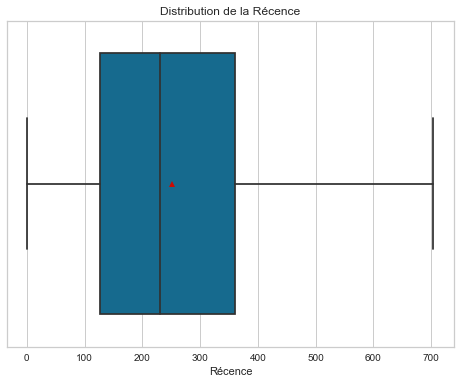

In [12]:
plt.figure(figsize=(8, 6))

fig1 = sns.boxplot(x='Récence',
                   data=RFM,
                   showmeans=True
                   )

fig1.set_title('Distribution de la Récence')

* Affichage en **distribution** :

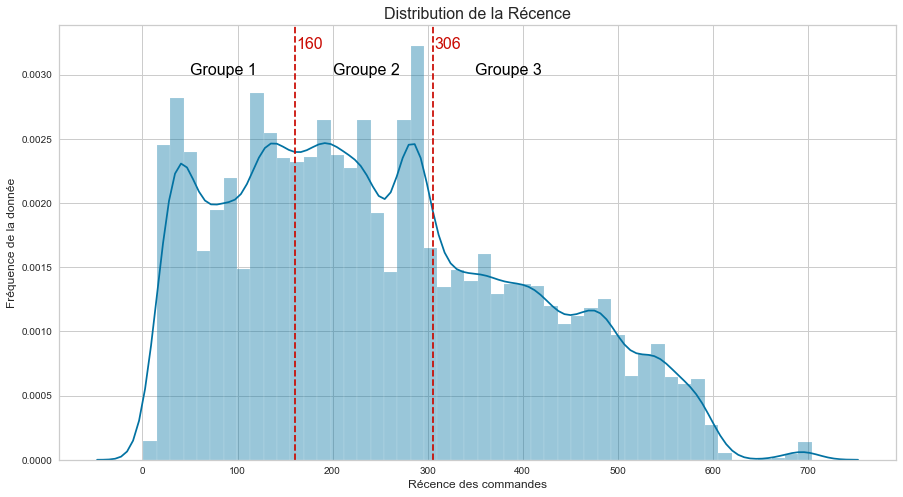

In [13]:
plt.figure(figsize=(15, 8))
sns.distplot(RFM['Récence'], kde=True)
plt.title ("Distribution de la Récence", fontsize=16)
plt.ylabel ("Fréquence de la donnée", fontsize=12)
plt.xlabel ("Récence des commandes", fontsize=12)
text_1 = 'Groupe 1'
text_2 = 'Groupe 2'
text_3 = 'Groupe 3'
plt.axvline(160, color='r', linestyle='--')
plt.text(50, 0.0030, text_1, fontsize=16, color='black')
plt.axvline(306, color='r', linestyle='--')
plt.text(162, 0.0032, '160', fontsize=16, color='r')

plt.text(200, 0.0030, text_2, fontsize=16, color='black')
plt.text(307, 0.0032, '306', fontsize=16, color='r')

plt.text(350, 0.0030, text_3, fontsize=16, color='black')

* Affichage de la **Frequence** :

In [14]:
RFM['Frequence'].value_counts(normalize=True)*100

1     97.025333
2      2.395093
3      0.303099
4      0.108542
5      0.053247
6      0.035839
7      0.028671
8      0.010240
12     0.008192
11     0.008192
9      0.007168
10     0.003072
13     0.003072
14     0.002048
15     0.002048
19     0.002048
26     0.001024
21     0.001024
22     0.001024
29     0.001024
Name: Frequence, dtype: float64

* Plus de 99% des clients ont une fréquence d'achat inférieure ou égale à 5. On va restreindre notre jeu de données.

In [15]:
RFM = RFM[RFM.Frequence <= 5]
RFM['Frequence'].value_counts(normalize=True)*100

1    97.136735
2     2.397843
3     0.303447
4     0.108667
5     0.053308
Name: Frequence, dtype: float64

* Exportation du dataframe **df** :

In [16]:

df = pd.DataFrame({'Nombre achats': [1, 2, 3, 4, 5],
                   'Effectif': RFM['Frequence'].value_counts(),
                   'Pourcentage': RFM['Frequence'].value_counts(normalize=True)*100})

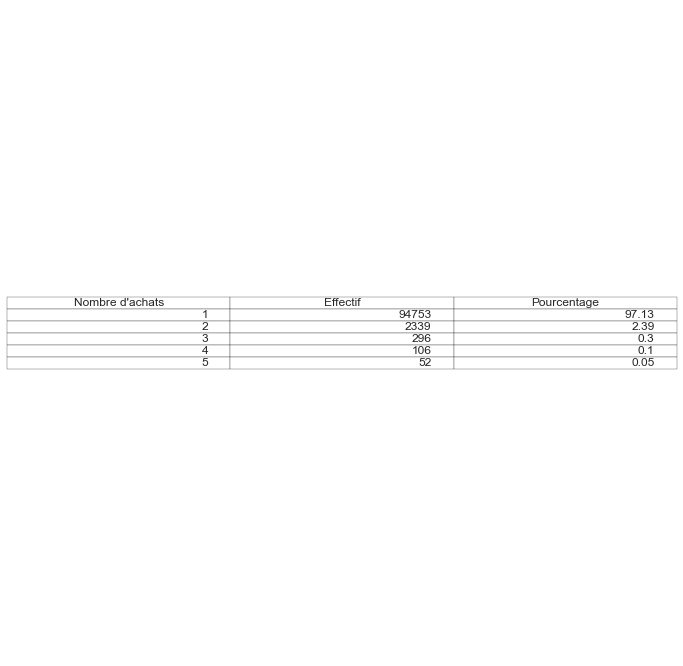

In [17]:
plt.figure(figsize=(12, 12))

data=[[1, 94753, 97.13],
      [2, 2339, 2.39],
      [3, 296, 0.30],
      [4, 106, 0.10],
      [5, 52, 0.05]]

column_labels=["Nombre d'achats", "Effectif", "Pourcentage"]
plt.axis('tight')
plt.axis('off')
plt.table(cellText=data, colLabels=column_labels, loc="center")

plt.show()

Text(0.5, 0, "Frequence d'achat")

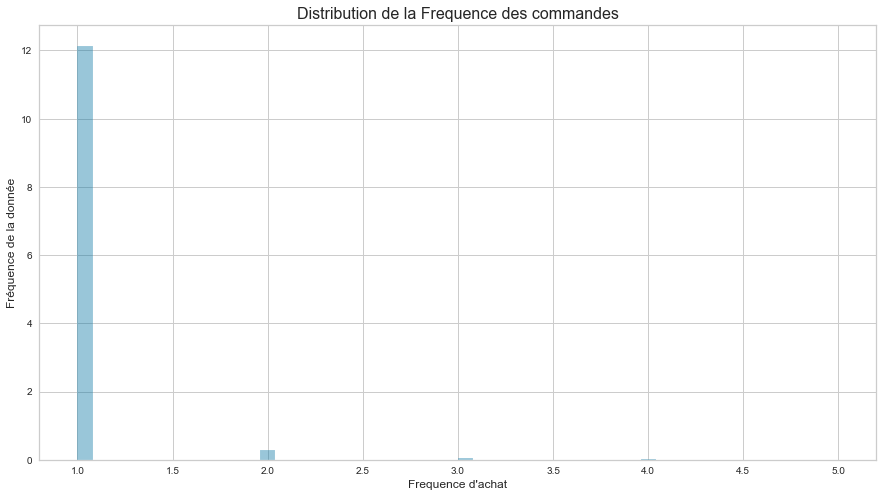

In [18]:
plt.figure(figsize=(15, 8))
sns.distplot(RFM['Frequence'], kde=True)
plt.title ("Distribution de la Frequence des commandes", fontsize=16)
plt.ylabel ("Fréquence de la donnée", fontsize=12)
plt.xlabel ("Frequence d'achat", fontsize=12)

* Affichage du montant :

In [19]:
RFM['Montant'].describe([0.33, 0.67, 0.75, 0.90, 0.95])

count    97546.000000
mean       159.780566
std        218.510326
min          0.000000
33%         73.150000
50%        105.280000
67%        148.150000
75%        176.255000
90%        305.680000
95%        446.215000
max      13664.080000
Name: Montant, dtype: float64

Text(0.5, 1.0, 'Distribution du Montant')

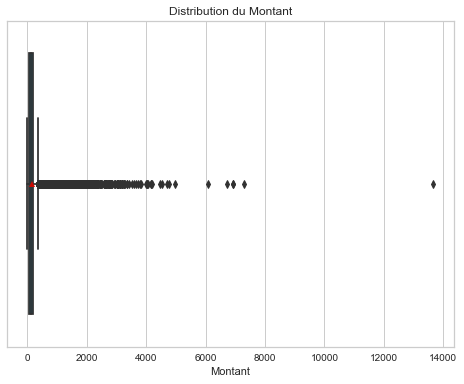

In [20]:
plt.figure(figsize=(8, 6))

fig1 = sns.boxplot(x='Montant',
                   data=RFM,
                   showmeans=True
                   )
fig1.set_title('Distribution du Montant')

* On voit clairement des outliers au-delà de **446 REALS**, on va aussi restreindre notre jeu de données.

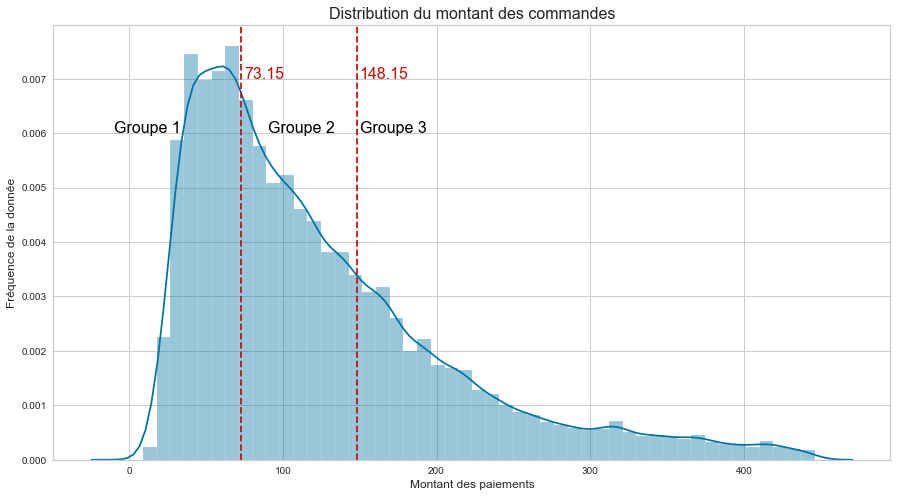

In [21]:
RFM = RFM[RFM.Montant <= 446]

plt.figure(figsize=(15, 8))
sns.distplot(RFM['Montant'], kde=True)
plt.title ("Distribution du montant des commandes", fontsize=16)
plt.ylabel ("Fréquence de la donnée", fontsize=12)
plt.xlabel ("Montant des paiements", fontsize=12)
text_1 = 'Groupe 1'
text_2 = 'Groupe 2'
text_3 = 'Groupe 3'
plt.axvline(73, color='r', linestyle='--')
plt.text(-10, 0.006, text_1, fontsize=16, color='black')
plt.axvline(148, color='r', linestyle='--')
plt.text(90, 0.006, text_2, fontsize=16, color='black')
plt.text(75, 0.007, '73.15', fontsize=16, color='r')

plt.text(150, 0.006, text_3, fontsize=16, color='black')
plt.text(150, 0.007, '148.15', fontsize=16, color='r')

### On va définir des groupes de clients en fonction des valeurs RFM.

> Pour cela, on va découper **la Récence et le Montant** en 3 quartiles qui vont définir 3 groupes (1, 2, 3) et on découpe **la fréquence** en 2 groupes (1 ou 2). Ceux qui commandent une fois ou ceux qui commandent régulièrement.

In [22]:
RFM['R_group'] = pd.qcut(RFM['Récence'], 3,
                         labels=[1, 2, 3]).astype(str)
RFM['M_group'] = pd.qcut(RFM['Montant'], 3,
                         labels=[1, 2, 3]).astype(str)
RFM['F_group'] = RFM['Frequence']\
                    .apply(lambda x: '1' if x==1 else '2')

RFM['RFM_group'] = RFM['R_group'] + RFM['F_group'] + RFM['M_group']

* Définition de différents segments clients :


  * Fidèle   - '123' - clients fidèles qui achètent régulièrement et font des achats d'un montant important
  * One shot - '311', '312', '313' - clients ayant faits des achats ponctuels puis sont partis
  * Nouveau  - '111', '112', '113' - Nouveaux clients
  * Gros     - '323', '213', '223' - clients générant des gros revenues
  * Régulier - '221', '222', '321', '322', '121', '122', '211', '212', - clients réguliers et loyaux

In [23]:
def segment(x):
    
    
    if x == '123':
        return 'Fidele'
    elif x in ['311', '312', '313']:
        return 'One shot'
    elif x in ['111', '112', '113']:
        return 'Nouveau'
    elif x in ['323', '213', '223']:
        return 'Gros'
    else:
        return 'Régulier'
    

RFM['segment'] = RFM['RFM_group'].apply(segment)
RFM['segment'].value_counts(normalize=True) * 100

Nouveau     32.545918
One shot    32.027928
Régulier    23.642976
Gros        11.514471
Fidele       0.268707
Name: segment, dtype: float64

> <font color='red'> Il y a très peu de clients fidèles sur le site **Olist**. Les nouveaux clients ou ceux effectuant des achats ponctuels sont les plus nombreux.</font>

In [24]:
import plotly.express as px

fig_1 = px.box(RFM, x="Récence", y="segment")
fig_1.update_layout(title="Distribution de la récence selon le segment client")

fig_2 = px.box(RFM, x="Frequence", y="segment")
fig_2.update_layout(title="Distribution de la fréquence selon le segment client")

fig_3 = px.box(RFM, x="Montant", y="segment")
fig_3.update_layout(title="Distribution de montant selon le segment client")


fig_1.show()
fig_2.show()
fig_3.show()

* Calcul des **RFMs moyens par segment** :

In [25]:
RFM_seg = RFM.groupby('segment')\
         .agg(Récence_mean=('Récence', 'mean'),
              Frequence_mean=('Frequence', 'mean'),
              Montant_mean=('Montant', 'mean'),
              Seg_size=('Récence', 'size'))

RFM_seg.head()

,Récence_mean,Frequence_mean,Montant_mean,Seg_size
segment,,,,
Fidele,86.939759,2.220884,221.581847,249
Gros,238.470478,1.062324,220.884907,10670
Nouveau,88.470307,1.000000,124.532618,30159
One shot,431.337141,1.000000,122.221217,29679
Régulier,236.693824,1.106349,74.234247,21909


In [26]:
fig_1 = px.box(RFM_seg, x="Récence_mean")
fig_1.update_layout(title="Distribution de la récence moyenne des segments")
fig_1.show()

In [27]:
fig_2 = px.box(RFM_seg, x="Frequence_mean")
fig_2.update_layout(title="Distribution de la fréquence moyenne des segments")
fig_2.update_traces(marker_color='rgb(0,255,0)',
                    marker_line_color='rgb(8,48,107)',
                    marker_line_width=1.5, opacity=0.6)
fig_2.show()

In [28]:
fig_3 = px.box(RFM_seg, x="Montant_mean")
fig_3.update_layout(title="Distribution du montant moyen des segments")
fig_3.update_traces(marker_color='rgb(255,102,255)',
                    marker_line_color='rgb(8,48,107)',
                    marker_line_width=1.5, opacity=0.6)
fig_3.show()

In [29]:
fig_4 = px.box(RFM_seg, x="Seg_size")
fig_4.update_layout(title="Distribution de la taille des segments")
fig_4.update_traces(marker_color='rgb(255,255,102)',
                    marker_line_color='rgb(8,48,107)',
                    marker_line_width=1.5, opacity=0.6)

fig_4.show()

Visualisation des segments de client :

In [30]:
RFM_seg

,Récence_mean,Frequence_mean,Montant_mean,Seg_size
segment,,,,
Fidele,86.939759,2.220884,221.581847,249
Gros,238.470478,1.062324,220.884907,10670
Nouveau,88.470307,1.000000,124.532618,30159
One shot,431.337141,1.000000,122.221217,29679
Régulier,236.693824,1.106349,74.234247,21909


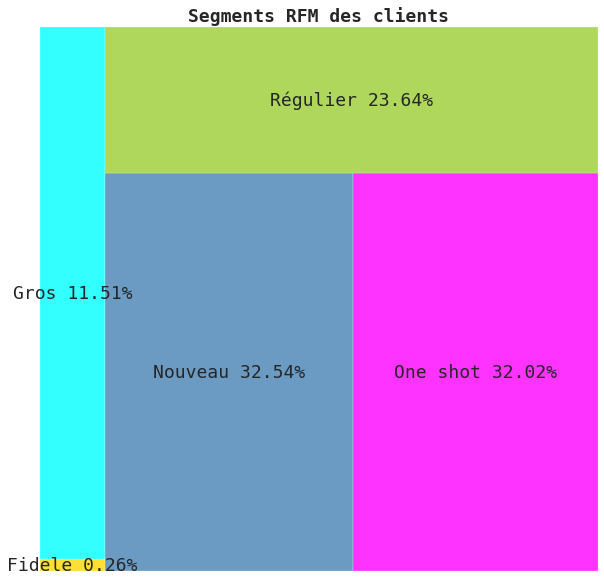

In [31]:
import squarify

values = (RFM["segment"].value_counts(normalize=True)*100)\
          .values.tolist()
label = ['Fidele 0.26%', 'Gros 11.51%', 'Nouveau 32.54%',
         'One shot 32.02%', 'Régulier 23.64%']


font = {'family' : 'monospace',
        'weight' : 'normal',
        'size' : 18}

plt.rc('font', **font)


fig = plt.gcf()
ax = fig.add_subplot()
fig.set_size_inches(10, 10)
squarify.plot(sizes=RFM_seg['Seg_size'], 
              label=label,
              color=['gold', 'aqua', 'steelblue',
                       'magenta', 'yellowgreen'],
              alpha=0.8)

plt.title("Segments RFM des clients", fontsize=18,
          fontweight="bold")
plt.axis('off')
plt.show()

## b) RFM avec K-means

* Utilisation de la méthode du coude en testant le modèle avec l'hyperparamétre des plus proches voisins **k de 4 à 15**:

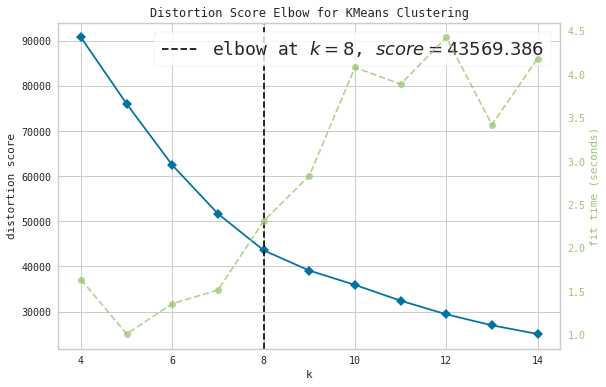

In [32]:
plt.rcParams["figure.figsize"] = (9, 6)
model = KMeans()
visualizer = KElbowVisualizer(model, k=(4, 15))

X = RFM[['Récence', 'Frequence', 'Montant']].values
std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

visualizer.fit(X_scaled)    
visualizer.poof()

> <font color='red'>ANALYSE</font>


> <font color='red'>Le choix de **k=8** est justifié par un **coude** de la courbe du score de distortion.</font>

* Recherche des hyperparamètres optimales pour le kmeans avec 8 clusters :

In [33]:
model = KMeans(n_clusters=8, init='random', n_init=10)
b = model.fit(X_scaled).labels_

In [34]:
from sklearn.metrics import make_scorer
from sklearn.metrics import adjusted_rand_score
from sklearn.model_selection import GridSearchCV



sc=make_scorer(adjusted_rand_score)
parameters = {'init':('k-means++', 'random'),
              'max_iter':[100,200,300],
              'n_init':[5,10,15]}

clf = GridSearchCV(model, parameters, scoring=sc)
clf.fit(X_scaled, b)

indx=clf.cv_results_['rank_test_score'].tolist().index(1)
print("ARI score mean :"+str(clf.cv_results_['mean_test_score'][indx]))
print("Best parameters: "+str(clf.best_params_))

ARI score mean :0.9802473605850717
Best parameters: {'init': 'random', 'max_iter': 300, 'n_init': 5}


> <font color='red'>ANALYSE</font>

> <font color='red'> Pour **k=8**, on a entrainé notre modèle avec les hyperparamètres **init, max_iter, n_init** optimales. On a un score ARI moyen proche de 1, ce qui reflète un très bon clustering des données RFM.</font>

* Affichage du coefficient de silhouette pour la mesure de la performance en fonction des 8 clusters :

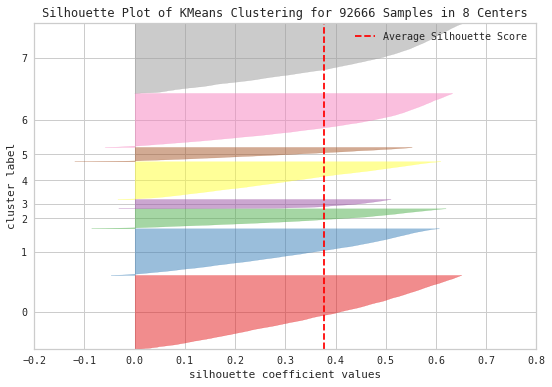

In [35]:
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X_scaled) 
visualizer.poof()

> <font color='red'>ANALYSE</font>

> <font color='red'> Pour chaque cluster, le coefficient de silhouette est supérieur à la moyenne (ligne rouge).
Cela indique une bonne séparation des 8 clusters et un bon choix du paramètre **k=8**.</font>

* Projection du jeu de données sur le premier plan factoriel après une ACP :

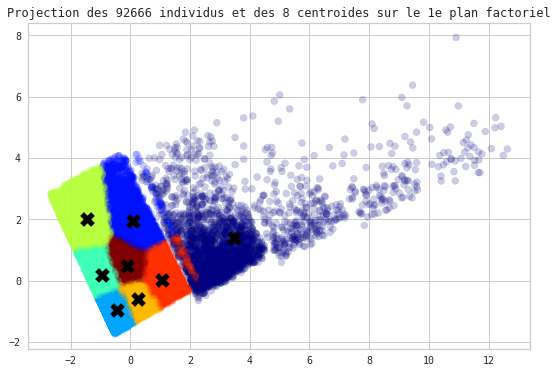

In [36]:
model.fit(X_scaled)

plt.figure()
clusters = model.labels_

pca = decomposition.PCA(n_components=3).fit(X_scaled)
X_projected = pca.transform(X_scaled)

centroids = model.cluster_centers_
centroids_projected = pca.transform(centroids)

plt.scatter(X_projected[:, 0], X_projected[:, 1], 
            c=clusters.astype(np.float), 
            cmap='jet', alpha=.2)
plt.scatter(centroids_projected[:,0], 
            centroids_projected[:,1],
            marker='X',
            color='black',
            alpha=1,
            s=200)

plt.title("Projection des {} individus et des 8 centroides sur le 1e plan factoriel".format(X_projected.shape[0]))
plt.show()

* Interprêtation des 8 clusters RFM par KMeans et nombre d'individus par cluster : 

In [37]:
RFM_cluster = RFM.copy()
RFM_cluster.drop(columns=['R_group', 'M_group', 'F_group',
                          'RFM_group', 'segment'], inplace=True)

RFM_cluster['Cluster Labels'] = clusters
RFM_cluster['Segment'] = RFM_cluster['Cluster Labels']\
                         .map({0:'Cluster 1', 1:'Cluster 2',
                               2:'Cluster 3', 3:'Cluster 4',
                               4:'Cluster 5', 5:'Cluster 6',
                               6:'Cluster 7', 7:'Cluster 8'})

RFM_cluster['Segment'] = RFM_cluster['Segment'].astype('category')
RFM_cluster['Segment'] = RFM_cluster['Segment']\
                        .cat.reorder_categories(['Cluster 1',
                                                 'Cluster 2',
                                                 'Cluster 3',
                                                 'Cluster 4',
                                                 'Cluster 5',
                                                 'Cluster 6',
                                                 'Cluster 7',
                                                 'Cluster 8'])

RFM_cluster.head()

,Récence,Frequence,Montant,Cluster Labels,Segment
customer_id,,,,,
00012a2ce6f8dcda20d059ce98491703,299,1,114.74,7,Cluster 8
000161a058600d5901f007fab4c27140,420,1,67.41,6,Cluster 7
0001fd6190edaaf884bcaf3d49edf079,560,1,195.42,1,Cluster 2
0002414f95344307404f0ace7a26f1d5,389,1,179.35,7,Cluster 8
000379cdec625522490c315e70c7a9fb,161,1,107.01,2,Cluster 3


In [38]:
RFM_cluster.rename(columns = {'Cluster Labels':'Total'}, inplace = True)

RFM_clu = RFM_cluster.groupby('Segment')\
                     .agg(Récence_mean=('Récence', 'mean'),
                          Frequence_mean=('Frequence', 'mean'),
                          Montant_mean=('Montant', 'mean'),
                          Total=('Récence', 'count'))

RFM_clu

,Récence_mean,Frequence_mean,Montant_mean,Total
Segment,,,,
Cluster 1,272.531521,2.245376,119.373567,2649
Cluster 2,467.664203,1.000000,263.527289,4330
Cluster 3,95.950094,1.000000,69.856035,20158
Cluster 4,112.267723,1.000000,175.066939,12752
Cluster 5,185.364432,1.000000,332.800156,5713
Cluster 6,262.795702,1.000000,66.125413,20426
Cluster 7,475.290096,1.000000,80.543824,15388
Cluster 8,299.408533,1.000000,162.872717,11250


* Normalisation des données de RFM_clu entre **0 et 1** :

In [41]:
X_clu = RFM_clu[['Récence_mean', 'Frequence_mean',
                 'Montant_mean']].values
MinMax_scale = preprocessing.MinMaxScaler(feature_range=(0, 1))\
                            .fit(X_clu)
X_clu_scaled = MinMax_scale.transform(X_clu)

In [43]:
RFM_clu_scale = pd.DataFrame(X_clu_scaled, columns=['Récence_mean',
                                                    'Frequence_mean',
                                                    'Montant_mean'])
RFM_clu_scale

,Récence_mean,Frequence_mean,Montant_mean
0,0.465496,1.0,0.199675
1,0.979897,0.0,0.740235
2,0.000000,0.0,0.013989
3,0.043016,0.0,0.408518
4,0.235710,0.0,1.000000
5,0.439831,0.0,0.000000
6,1.000000,0.0,0.054067
7,0.536348,0.0,0.362791


In [53]:
categories = ['Récence moyenne', 'Frequence moyenne', 'Montant moyen']

fig = go.Figure()


fig.add_trace(go.Scatterpolar(
      r=[RFM_clu_scale['Récence_mean'][0],
         RFM_clu_scale['Frequence_mean'][0],
         RFM_clu_scale['Montant_mean'][0]],
      theta=categories,
      fill='toself',
      name='Cluster 1'
))


fig.add_trace(go.Scatterpolar(
      r=[RFM_clu_scale['Récence_mean'][1],
         RFM_clu_scale['Frequence_mean'][1],
         RFM_clu_scale['Montant_mean'][1]],
      theta=categories,
      fill='toself',
      name='Cluster 2'
))

fig.add_trace(go.Scatterpolar(
      r=[RFM_clu_scale['Récence_mean'][2],
         RFM_clu_scale['Frequence_mean'][2],
         RFM_clu_scale['Montant_mean'][2]],
      theta=categories,
      fill='toself',
      name='Cluster 3'
))

fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=False,
      range=[0, 1]
    )),
  title="Radar Chart des Clusters 1, 2, 3",
  showlegend=False
)

fig.show()

> <font color='red'>ANALYSE</font>

> <font color='red'>Les clusters **1 et 3** se rapprochent des clients **One Shot** mis en évidence dans la segmentation métier RFM car leur récence moyenne est élevé et la fréquence est 1 ce qui indiquent un achat passé ponctuel. Le cluster 2 se rapproche des **Gros** clients générant de gros revenus pour le site Olist.</font>

In [56]:
fig_1 = go.Figure()


fig_1.add_trace(go.Scatterpolar(
      r=[RFM_clu_scale['Récence_mean'][3],
         RFM_clu_scale['Frequence_mean'][3],
         RFM_clu_scale['Montant_mean'][3]],
      theta=categories,
      fill='toself',
      name='Cluster 4'
))


fig_1.add_trace(go.Scatterpolar(
      r=[RFM_clu_scale['Récence_mean'][4],
         RFM_clu_scale['Frequence_mean'][4],
         RFM_clu_scale['Montant_mean'][4]],
      theta=categories,
      fill='toself',
      name='Cluster 5'
))

fig_1.add_trace(go.Scatterpolar(
      r=[RFM_clu_scale['Récence_mean'][5],
         RFM_clu_scale['Frequence_mean'][5],
         RFM_clu_scale['Montant_mean'][5]],
      theta=categories,
      fill='toself',
      name='Cluster 6'
))

fig_1.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=False,
      range=[0, 1]
    )),
  title="Radar Chart des Clusters 4, 5, 6",
  showlegend=False
)

fig_1.show()

> <font color='red'>ANALYSE</font>

> <font color='red'>Le cluster **5** se rapprochent des clients **One Shot** mis en évidence dans la segmentation métier RFM car leur récence moyenne est élevé et la fréquence est 1 ce qui indiquent un achat passé ponctuel. Le cluster 4 se rapproche des clients **réguliers et loyaux** effectuant plusieurs achats de manière régulières. Le cluster 6 est similaire à la catégorie **Nouveaux clients**.</font>

In [57]:
fig_2 = go.Figure()

fig_2.add_trace(go.Scatterpolar(
      r=[RFM_clu_scale['Récence_mean'][6],
         RFM_clu_scale['Frequence_mean'][6],
         RFM_clu_scale['Montant_mean'][6]],
      theta=categories,
      fill='toself',
      name='Cluster 7'
))


fig_2.add_trace(go.Scatterpolar(
      r=[RFM_clu_scale['Récence_mean'][7],
         RFM_clu_scale['Frequence_mean'][7],
         RFM_clu_scale['Montant_mean'][7]],
      theta=categories,
      fill='toself',
      name='Cluster 8'
))


fig_2.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=False,
      range=[0, 1]
    )),
  title="Radar Chart des Clusters 7 et 8",
  showlegend=False
)

fig_2.show()

> <font color='red'>ANALYSE</font>

> <font color='red'>Le cluster **7** se rapproche des clients **Fidèles** qui achètent régulièrement sur le site. Le cluster 8 se rapproche des clients **réguliers et loyaux**.</font>

## b) K-means sur les données brutes Olist

* Utilisation de la méthode du coude en testant le modèle avec l'hyperparamétre des plus proches voisins **k de 4 à 15**:

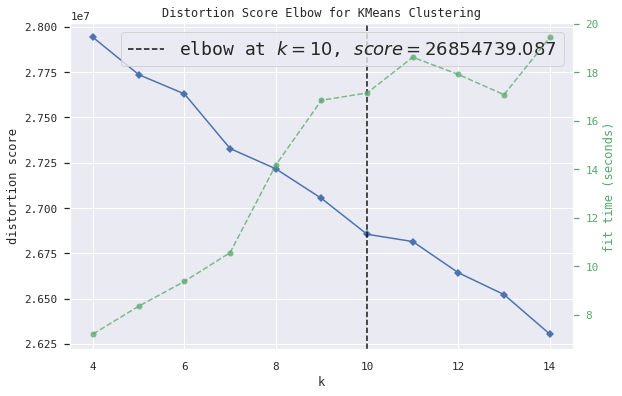

In [149]:
X = data_df.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

plt.rcParams["figure.figsize"] = (9,6)

model = KMeans()
visualizer = KElbowVisualizer(model, k=(4,15))
visualizer.fit(X_scaled)    
visualizer.poof()  

> <font color='red'>ANALYSE</font>


> <font color='red'>Le choix de **k=10** est justifié par un **coude** de la courbe du score de distortion.</font>

* Recherche des hyperparamètres optimales pour le kmeans avec 10 clusters :

In [29]:
model = KMeans(n_clusters=10, init='random', n_init=10)
b = model.fit(X_scaled).labels_

sc=make_scorer(adjusted_rand_score)
parameters = {'init':('k-means++', 'random'),
              'max_iter':[100,200,300],
              'n_init':[5,10,15]}

clf = GridSearchCV(model, parameters, scoring=sc)
clf.fit(X_scaled, b)

indx=clf.cv_results_['rank_test_score'].tolist().index(1)
print("ARI score mean :"+str(clf.cv_results_['mean_test_score'][indx]))
print("Best parameters: "+str(clf.best_params_))

ARI score mean :0.7337660503837689
Best parameters: {'init': 'random', 'max_iter': 100, 'n_init': 15}


> <font color='red'>ANALYSE</font>

> <font color='red'> Pour **k=10**, on a entrainé notre modèle avec les hyperparamètres **init, max_iter, n_init** optimales. On a un score ARI moyen proche de 0.80, ce qui reflète un bon clustering des données brutes Olist.</font>

* Affichage du coefficient de silhouette pour la mesure de la performance en fonction des 10 clusters :

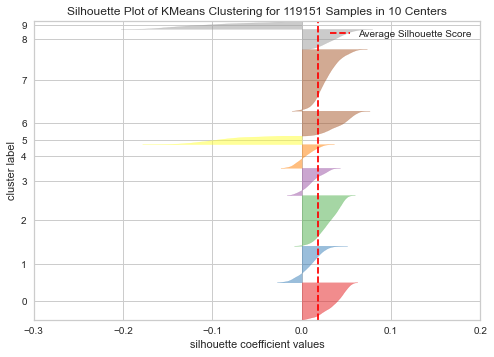

In [32]:
visualizer = SilhouetteVisualizer(model)

visualizer.fit(X_scaled) 
visualizer.poof() 

* Projection du jeu de données sur le premier plan factoriel après une ACP :

In [33]:
pca = decomposition.PCA(n_components=70).fit(X_scaled)
X_projected = pca.transform(X_scaled)

print(pca.explained_variance_ratio_.cumsum())

[0.04578079 0.07082039 0.0877211  0.10355876 0.11919313 0.13116683
 0.14245771 0.15352056 0.16429254 0.17485219 0.18478176 0.19449165
 0.20415618 0.21358116 0.22295685 0.23196682 0.24087895 0.24967124
 0.25826809 0.26639823 0.27443277 0.28230036 0.28990547 0.29729318
 0.30456623 0.31153852 0.3184828  0.32497519 0.3313151  0.33729686
 0.34317162 0.34895779 0.35464507 0.36020953 0.36547611 0.37068448
 0.37580101 0.38082457 0.38574644 0.39063114 0.39550369 0.40031369
 0.40507529 0.40975271 0.414378   0.41899095 0.42357946 0.42813709
 0.43263751 0.4371277  0.44150684 0.44586748 0.4501875  0.4544915
 0.45879024 0.46303983 0.46727811 0.47147969 0.47566706 0.47983649
 0.48398241 0.488111   0.49222427 0.49632229 0.50041892 0.50449488
 0.5085603  0.51260765 0.51664424 0.52067101]


> Les 70 premières composantes principales expliquent plus de de 50% de la variance de notre jeu de données.

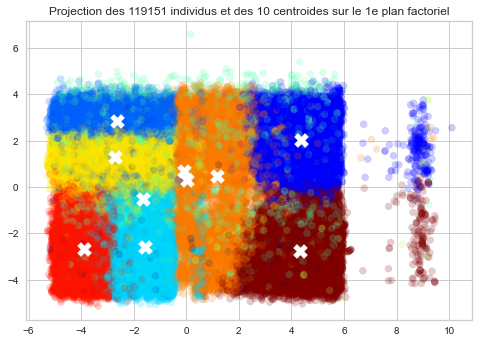

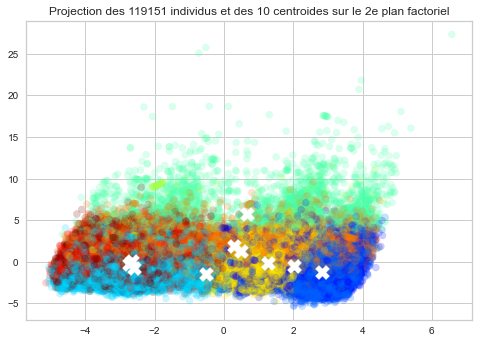

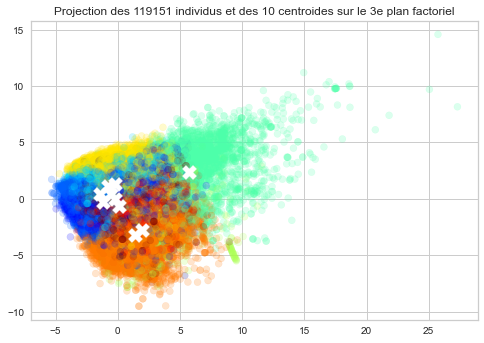

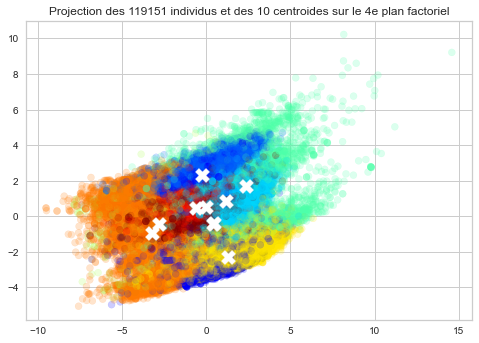

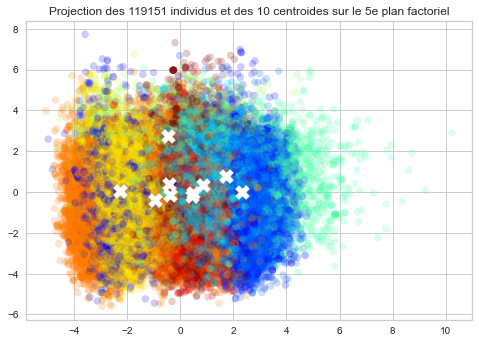

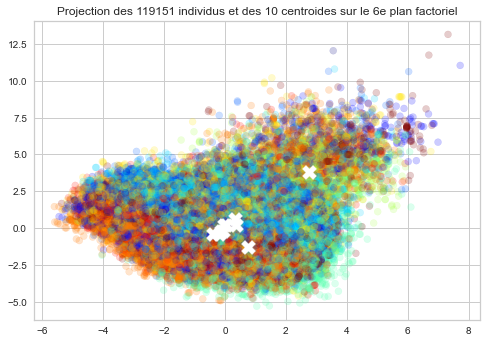

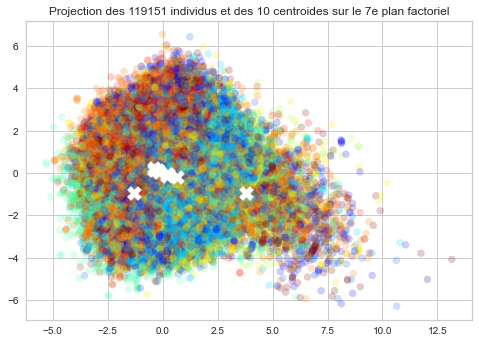

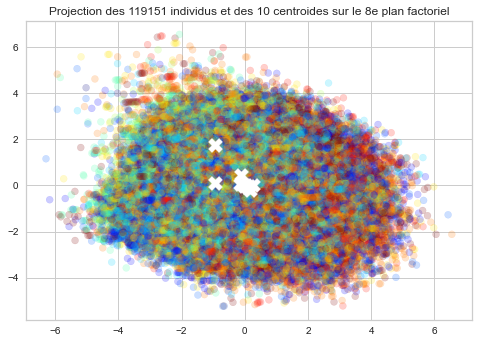

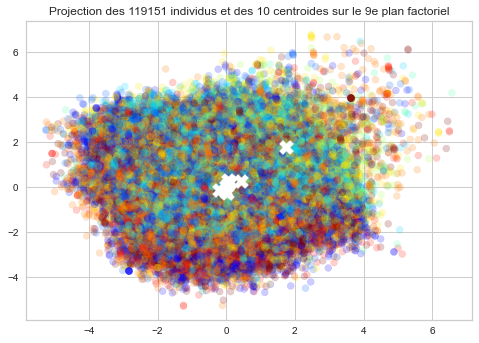

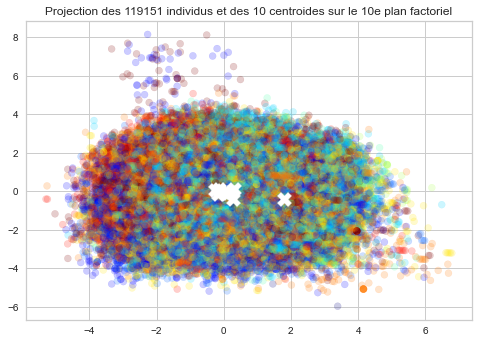

In [34]:
model.fit(X_scaled)

plt.figure()
clusters = model.labels_


centroids = model.cluster_centers_
centroids_projected = pca.transform(centroids)

for i in range(10):
    plt.scatter(X_projected[:, i], X_projected[:, i+1], 
                c=clusters.astype(np.float), 
                cmap='jet', alpha=.2)
    plt.scatter(centroids_projected[:, i], 
                centroids_projected[:, i+1],
                marker='X',
                color='white',
                alpha=1,
                s=200)

    plt.title("Projection des {} individus et des 10 centroides sur le {}e plan factoriel".format(X_projected.shape[0], i+1))
    plt.show()
    
    

> <font color='red'>ANALYSE</font>

> <font color='red'> Pour chaque cluster, le coefficient de silhouette est supérieur à la moyenne (ligne rouge).
Cela indique une bonne séparation de 6 clusters. 4 clusters sont très proches donc les données sont séparés en 7 clusters.</font>

* Interprêtation des 10 clusters RFM par KMeans et nombre d'individus par cluster : 

In [35]:
data_df_cluster = data_df.copy()

data_df_cluster['Cluster Labels'] = clusters
data_df_cluster['Segment'] = data_df_cluster['Cluster Labels']\
                             .map({0:'Cluster 1', 1:'Cluster 2',
                                   2:'Cluster 3', 3:'Cluster 4',
                                   4:'Cluster 5', 5:'Cluster 6',
                                   6:'Cluster 7', 7:'Cluster 8',
                                   8:'Cluster 9', 9:'Cluster 10'})

data_df_cluster['Segment'] = data_df_cluster['Segment']\
                                .astype('category')
data_df_cluster['Segment'] = data_df_cluster['Segment']\
                        .cat.reorder_categories(['Cluster 1',
                                                 'Cluster 2',
                                                 'Cluster 3',
                                                 'Cluster 4',
                                                 'Cluster 5',
                                                 'Cluster 6',
                                                 'Cluster 7',
                                                 'Cluster 8',
                                                 'Cluster 9',
                                                 'Cluster 10'])
                                                

data_df_cluster.tail()

,order_purchase_year,order_purchase_month,order_purchase_hour,order_purchase_day,order_item_id,price,freight_value,payment_sequential,payment_installments,payment_value,...,review_answer_time_day_Night,review_answer_dayofweek_Fri,review_answer_dayofweek_Mon,review_answer_dayofweek_Sat,review_answer_dayofweek_Sun,review_answer_dayofweek_Thu,review_answer_dayofweek_Tue,review_answer_dayofweek_Wed,Cluster Labels,Segment
119146,2018.0,7.0,10.0,1.0,1.0,79.0,14.13,1.0,1.0,93.13,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,3,Cluster 4
119147,2017.0,3.0,19.0,11.0,1.0,19.7,10.96,1.0,1.0,30.66,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,7,Cluster 8
119148,2018.0,7.0,9.0,24.0,1.0,399.0,45.07,1.0,1.0,444.07,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,3,Cluster 4
119149,2018.0,5.0,21.0,22.0,1.0,219.9,24.12,1.0,4.0,244.02,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2,Cluster 3
119150,2018.0,5.0,17.0,15.0,1.0,15.5,12.79,1.0,1.0,28.29,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,3,Cluster 4


In [36]:
data_df_cluster.rename(columns = {'Cluster Labels':'Total'},
                       inplace = True)

data_df_clu = data_df_cluster.groupby('Segment')\
              .agg(payment_value_mean=('payment_value', 'mean'),
                   review_score_mode=('review_score',
                                      lambda x: x.value_counts().index[0]),
                   price_mean=('price', 'mean'),
                   pay_inst_mode=('payment_installments',
                                  lambda x: x.value_counts().index[0]),
                   cust_zip_code_mode=('customer_zip_code_prefix',
                                       lambda x: x.value_counts().index[0]),
                   seller_zip_code_mode=('seller_zip_code_prefix',
                                         lambda x: x.value_counts().index[0]),
                   ord_purch_year_mode=('order_purchase_year',
                                        lambda x: x.value_counts().index[0]),
                   ord_purch_month_mode=('order_purchase_month',
                                         lambda x: x.value_counts().index[0]),
                   ord_purch_hour_mode=('order_purchase_hour',
                                        lambda x: x.value_counts().index[0]),
                   Total=('order_purchase_year', 'count'))

data_df_clu

,payment_value_mean,review_score_mode,price_mean,pay_inst_mode,cust_zip_code_mode,seller_zip_code_mode,ord_purch_year_mode,ord_purch_month_mode,ord_purch_hour_mode,Total
Segment,,,,,,,,,,
Cluster 1,91.885478,5.0,71.043676,1.0,29090.0,2274.0,2018.0,5.0,16.0,272
Cluster 2,151.514524,5.0,107.529218,1.0,23070.0,14940.0,2017.0,11.0,14.0,18934
Cluster 3,150.246590,5.0,109.252720,1.0,24220.0,14940.0,2018.0,5.0,21.0,15078
Cluster 4,156.537197,5.0,101.056985,1.0,13141.0,14940.0,2018.0,5.0,11.0,15196
Cluster 5,774.063821,5.0,559.280523,1.0,21910.0,8577.0,2018.0,7.0,15.0,4106
Cluster 6,155.508785,1.0,130.452341,1.0,78065.0,14940.0,2018.0,3.0,12.0,1251
Cluster 7,150.673960,5.0,106.064231,1.0,6900.0,14940.0,2018.0,1.0,16.0,20357
Cluster 8,144.993732,5.0,105.966919,1.0,3227.0,14940.0,2017.0,5.0,14.0,15095
Cluster 9,152.191180,5.0,101.462932,1.0,98700.0,14940.0,2018.0,1.0,11.0,12819


> La librairie **SHAP (SHapley Additive exPlanation)** permet de visualiser les clusters et les interpréter localement.

In [41]:
from sklearn.model_selection import cross_val_score
from lightgbm import LGBMClassifier
import shap

data_df_clu = data_df.copy()
for c in data_df_clu.select_dtypes(include='object'):
    data_df_clu[c] = data_df_clu[c].astype('category')


model = LGBMClassifier(subsample=1, colsample_by_tree=1,
                       colsample_bylevel=1)

In [42]:
cv_scores_kp = cross_val_score(model, data_df_clu, clusters, scoring='f1_weighted')
print(f'CV F1 score pour les clusters K-Prototypes est {np.mean(cv_scores_kp)}')    

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
CV F1 score pour les clusters K-Prototypes est 0.9837409093882993


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel


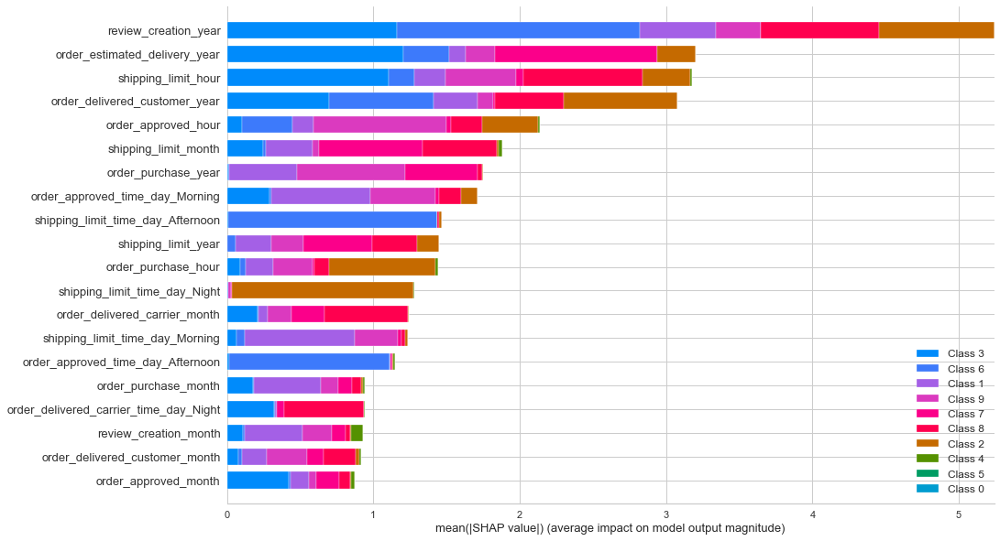

In [43]:
model.fit(data_df_clu, clusters)
explainer_kp = shap.TreeExplainer(model)
shap_values_kp = explainer_kp.shap_values(data_df_clu)
shap.summary_plot(shap_values_kp, data_df_clu, plot_type="bar",
                  plot_size=(15, 10))

> <font color='red'>ANALYSE</font>

> <font color='red'> Pour classifier les 10 clusters K-Means, LightGBM a besoin de 8 variables dont 4 avec une plus grande importance à savoir **review_creation_year, order_estimated_delivery_year, shipping_limit_hour, order_delivered_customer_year**.
La performance mesurée par le **F1 score** proche de 1, indique que les clusters sont bien définis.</font>

## c) Evaluation de la performance du clustering


In [253]:
data_df.sort_values(by = ['order_purchase_year',
                          'order_purchase_month',
                          'order_purchase_day'], inplace=True)



data_df_jan18_1 = data_df.loc[(data_df['order_purchase_year'] == 2018)\
                             & (data_df['order_purchase_month'] <= 1)]
data_df_2 = data_df.loc[data_df['order_purchase_year'] == 2017]
data_df_3 = data_df.loc[data_df['order_purchase_year'] == 2016]
data_df_jan18 = pd.concat([data_df_3, data_df_2,
                           data_df_jan18_1])

data_df_fev18_1 = data_df.loc[(data_df['order_purchase_year'] == 2018)\
                             & (data_df['order_purchase_month'] <= 2)]
data_df_fev18 = pd.concat([data_df_3, data_df_2,
                           data_df_fev18_1])

data_df_mar18_1 = data_df.loc[(data_df['order_purchase_year'] == 2018)\
                             & (data_df['order_purchase_month'] <= 3)]
data_df_mar18 = pd.concat([data_df_3, data_df_2,
                           data_df_mar18_1])

data_df_avr18_1 = data_df.loc[(data_df['order_purchase_year'] == 2018)\
                             & (data_df['order_purchase_month'] <= 4)]
data_df_avr18 = pd.concat([data_df_3, data_df_2,
                           data_df_avr18_1])

data_df_mai18_1 = data_df.loc[(data_df['order_purchase_year'] == 2018)\
                             & (data_df['order_purchase_month'] <= 5)]
data_df_mai18 = pd.concat([data_df_3, data_df_2,
                           data_df_mai18_1])

data_df_jui18_1 = data_df.loc[(data_df['order_purchase_year'] == 2018)\
                             & (data_df['order_purchase_month'] <= 6)]
data_df_jui18 = pd.concat([data_df_3, data_df_2,
                           data_df_jui18_1])

data_df_juil18_1 = data_df.loc[(data_df['order_purchase_year'] == 2018)\
                             & (data_df['order_purchase_month'] <= 7)]
data_df_juil18 = pd.concat([data_df_3, data_df_2,
                           data_df_juil18_1])

### Utilisation de l'indice Davies Bouldin

> Cet indice permet de mesurer le rapport entre les distances intra-clusters et inter-clusters. Il permettra aussi de définir la fréquence de mise à jour de la segmentation client nécessaire à l'établissement d'un contrat.

* Calcul fait de septembre 2016 à janvier 2018 :

In [255]:
score = []
X = data_df_jan18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model = KMeans(n_clusters=10, init='random', 
               n_init=15, max_iter=100)

model.fit(X_scaled)
clusters_jan18 = model.labels_

print("Indice Davies Bouldin calculé en janvier 2018: %0.2f"
      % metrics.davies_bouldin_score(X_scaled, clusters_jan18))
score.append(metrics.davies_bouldin_score(X_scaled, clusters_jan18))

Indice Davies Bouldin calculé en janvier 2018: 3.26


* Calcul fait de septembre 2016 à février 2018 :

In [256]:
X = data_df_fev18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_fev18 = model.labels_

print("Indice Davies Bouldin calculé en février 2018: %0.2f"
      % metrics.davies_bouldin_score(X_scaled, clusters_fev18))
score.append(metrics.davies_bouldin_score(X_scaled, clusters_fev18))

Indice Davies Bouldin calculé en février 2018: 4.41


* Calcul fait de septembre 2016 à mars 2018 :

In [257]:
X = data_df_mar18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_mar18 = model.labels_

print("Indice Davies Bouldin calculé en mars 2018: %0.2f"
      % metrics.davies_bouldin_score(X_scaled, clusters_mar18))
score.append(metrics.davies_bouldin_score(X_scaled, clusters_mar18))

Indice Davies Bouldin calculé en mars 2018: 4.89


* Calcul fait de septembre 2016 à avril 2018 :

In [258]:
X = data_df_avr18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_avr18 = model.labels_

print("Indice Davies Bouldin calculé en avril 2018: %0.2f"
      % metrics.davies_bouldin_score(X_scaled, clusters_avr18))
score.append(metrics.davies_bouldin_score(X_scaled, clusters_avr18))

Indice Davies Bouldin calculé en avril 2018: 4.18


* Calcul fait de septembre 2016 à mai 2018 :

In [259]:
X = data_df_mai18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_mai18 = model.labels_

print("Indice Davies Bouldin calculé en mai 2018: %0.2f"
      % metrics.davies_bouldin_score(X_scaled, clusters_mai18))
score.append(metrics.davies_bouldin_score(X_scaled, clusters_mai18))

Indice Davies Bouldin calculé en mai 2018: 4.17


* Calcul fait de septembre 2016 à juin 2018 :

In [260]:
X = data_df_jui18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_jui18 = model.labels_

print("Indice Davies Bouldin calculé en juin 2018: %0.2f"
      % metrics.davies_bouldin_score(X_scaled, clusters_jui18))
score.append(metrics.davies_bouldin_score(X_scaled, clusters_jui18))

Indice Davies Bouldin calculé en juin 2018: 4.12


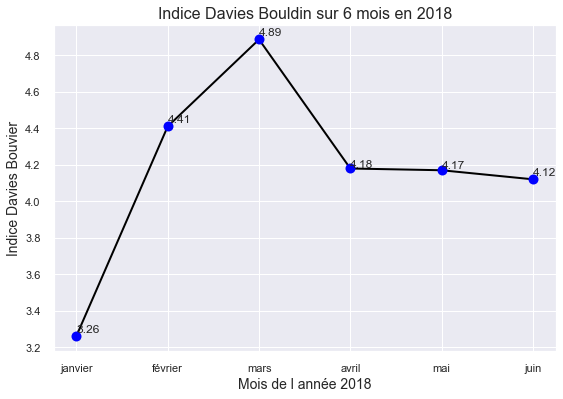

In [261]:
mois = ['janvier', 'février', 'mars', 'avril',
        'mai', 'juin']
plt.plot(mois, score, color='black',
         linestyle='solid', linewidth=2,
         markerfacecolor='blue', markersize=10,
         marker='o')
plt.title('Indice Davies Bouldin sur 6 mois en 2018',
          fontsize=16)
plt.ylabel('Indice Davies Bouvier', fontsize=14)
plt.xlabel('Mois de l année 2018', fontsize=14)
plt.text(mois[0], round(score[0], 2) + 0.02,
         str(round(score[0], 2)), fontsize=12)
plt.text(mois[1], round(score[1], 2) + 0.02,
         str(round(score[1], 2)), fontsize=12)
plt.text(mois[2], round(score[2], 2) + 0.02,
         str(round(score[2], 2)), fontsize=12)
plt.text(mois[3], round(score[3], 2) + 0.005,
         str(round(score[3], 2)), fontsize=12)
plt.text(mois[4], round(score[4], 2) + 0.01,
         str(round(score[4], 2)), fontsize=12)
plt.text(mois[5], round(score[5], 2) + 0.02,
         str(round(score[5], 2)), fontsize=12)

plt.show()

### ARI (Adjusted Rand Index) score :

> Ce score permet de mesurer la variabilité des clusters.

* Définition des clusters de septembre 2016 à janvier 2018 :

In [262]:
score_ari = []
X = data_df_jan18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model = KMeans(n_clusters=10, init='random', 
               n_init=15, max_iter=100)

model.fit(X_scaled)
clusters_jan18 = model.labels_

* Définition des clusters de septembre 2016 à février 2018 et calcul ARI score :

In [263]:
X = data_df_fev18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_fev18 = model.labels_

print("Adjusted Rand Index: %0.2f"
      % metrics.adjusted_rand_score(clusters_jan18, clusters_fev18[:63617]))
score_ari.append(metrics.adjusted_rand_score(clusters_jan18, clusters_fev18[:63617]))

Adjusted Rand Index: 0.69


* Définition des clusters de septembre 2016 à mars 2018 et calcul ARI score :

In [264]:
X = data_df_mar18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_mar18 = model.labels_


print("Adjusted Rand Index: %0.2f"
      % metrics.adjusted_rand_score(clusters_jan18, clusters_mar18[:63617]))
score_ari.append(metrics.adjusted_rand_score(clusters_jan18, clusters_mar18[:63617]))

Adjusted Rand Index: 0.67


* Définition des clusters de septembre 2016 à avril 2018 et calcul ARI score :

In [265]:
X = data_df_avr18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_avr18 = model.labels_


print("Adjusted Rand Index: %0.2f"
      % metrics.adjusted_rand_score(clusters_jan18, clusters_avr18[:63617]))
score_ari.append(metrics.adjusted_rand_score(clusters_jan18, clusters_avr18[:63617]))

Adjusted Rand Index: 0.66


* Définition des clusters de septembre 2016 à mai 2018 et calcul ARI score :

In [266]:
X = data_df_mai18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_mai18 = model.labels_


print("Adjusted Rand Index: %0.2f"
      % metrics.adjusted_rand_score(clusters_jan18, clusters_mai18[:63617]))
score_ari.append(metrics.adjusted_rand_score(clusters_jan18, clusters_mai18[:63617]))

Adjusted Rand Index: 0.62


* Définition des clusters de septembre 2016 à juin 2018 et calcul ARI score :

In [267]:
X = data_df_jui18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_jui18 = model.labels_

print("Adjusted Rand Index: %0.2f"
      % metrics.adjusted_rand_score(clusters_jan18, clusters_jui18[:63617]))
score_ari.append(metrics.adjusted_rand_score(clusters_jan18, clusters_jui18[:63617]))

Adjusted Rand Index: 0.60


* Définition des clusters de septembre 2016 à juillet 2018 et calcul ARI score :

In [268]:
X = data_df_juil18.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

model.fit(X_scaled)
clusters_juil18 = model.labels_

print("Adjusted Rand Index: %0.2f"
      % metrics.adjusted_rand_score(clusters_jan18, clusters_juil18[:63617]))
score_ari.append(metrics.adjusted_rand_score(clusters_jan18, clusters_juil18[:63617]))

Adjusted Rand Index: 0.41


* Représentation du score ARI :

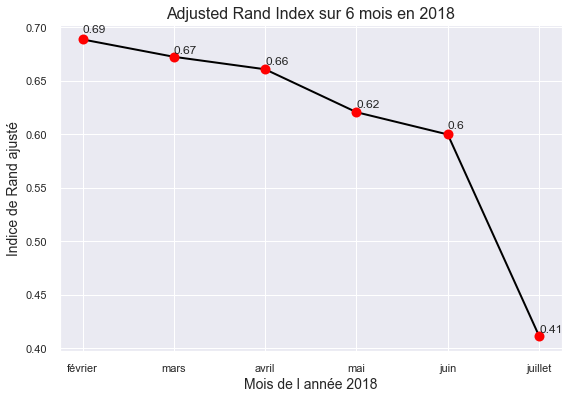

In [271]:
mois = ['février', 'mars', 'avril',
        'mai', 'juin', 'juillet']

plt.plot(mois, score_ari, color='black',
         linestyle='solid', linewidth=2,
         markerfacecolor='red', markersize=10,
         marker='o')
plt.title('Adjusted Rand Index sur 6 mois en 2018',
          fontsize=16)
plt.ylabel('Indice de Rand ajusté', fontsize=14)
plt.xlabel('Mois de l année 2018', fontsize=14)
plt.text(mois[0], round(score_ari[0], 2) + 0.005,
         str(round(score_ari[0], 2)), fontsize=12)
plt.text(mois[1], round(score_ari[1], 2) + 0.005,
         str(round(score_ari[1], 2)), fontsize=12)
plt.text(mois[2], round(score_ari[2], 2) + 0.005,
         str(round(score_ari[2], 2)), fontsize=12)
plt.text(mois[3], round(score_ari[3], 2) + 0.005,
         str(round(score_ari[3], 2)), fontsize=12)
plt.text(mois[4], round(score_ari[4], 2) + 0.005,
         str(round(score_ari[4], 2)), fontsize=12)
plt.text(mois[5], round(score_ari[5], 2) + 0.005,
         str(round(score_ari[5], 2)), fontsize=12)

plt.show()

> <font color='red'>ANALYSE</font>

> <font color='red'> En observant l'évolution du **score ARI**, une périodicité de **5 mois** est mis en évidence sur la répartition des clients en 8 clusters. En effet, cet indice détermine la co-appartenance des clients à un même cluster au fil des mois. En juillet, celui-ci descend en dessous de 0.5 ce qui indique un changement dans l'appartenance des clients à leur cluster. Il faudra de ce fait établir un contrat de maintenance de la segmentation des clients de Olist **tous les 5 mois** afin d'opérer un nouveau clustering.</font>

## d) DBSCAN (Density-Based Spatial Clustering of Applications with Noise) 

### Application sur les données RFM

> Dans un premier temps, on va définir les paramètres **epsilon_voisinage et n_min le nombre de proches voisins** en calculant les distances entre 2 proches voisins sur tout le jeu de données :

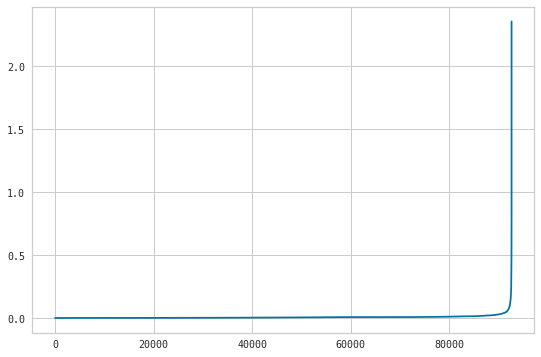

In [57]:

X = RFM[['Récence', 'Frequence', 'Montant']].values
std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

pca = decomposition.PCA(n_components=3).fit(X_scaled)
X_projected = pca.transform(X_scaled)


neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_scaled)
distances, indices = nbrs.kneighbors(X_scaled)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [58]:
print(pca.explained_variance_ratio_.cumsum())

[0.34284184 0.67394457 1.        ]


> Les distances des proches voisins sont toutes comprises dans **epsilon_voisinage = 0.2**.

* Clusters DBSCAN sur le 1er plan factoriel après ACP avec **epsilon_voisinage = 0.2 et n_min=min_samples=5** (nombre de points voisins):

Estimated number of clusters: 26
Estimated number of noise points: 292
Silhouette Coefficient: 0.366


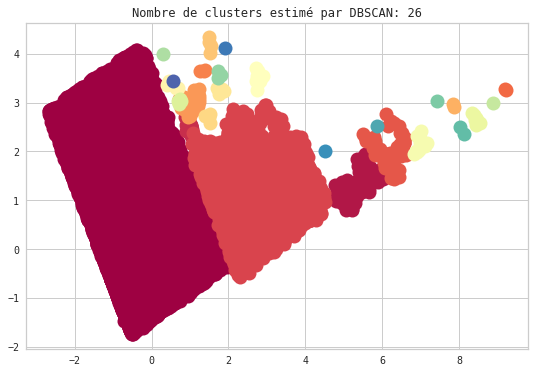

In [59]:
db = DBSCAN(eps=0.2, min_samples=5).fit(X_scaled)
labels = db.labels_
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_scaled, labels))


unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = X_projected[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)

    xy = X_projected[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)

plt.title('Nombre de clusters estimé par DBSCAN: %d' % n_clusters_)
plt.show()

### Application sur les données brutes Olist

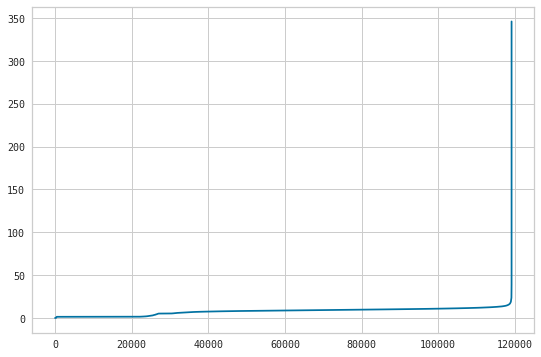

In [60]:
X = data_df.values

std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

pca = decomposition.PCA(n_components=70).fit(X_scaled)
X_projected = pca.transform(X_scaled)


neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_scaled)
distances, indices = nbrs.kneighbors(X_scaled)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [61]:
print(pca.explained_variance_ratio_.cumsum())

[0.04578079 0.07082039 0.08772112 0.10355871 0.11919302 0.13116644
 0.14245771 0.15352103 0.1642943  0.17485321 0.18478219 0.19449093
 0.204151   0.21357372 0.22294684 0.23195812 0.24087308 0.24966941
 0.25826698 0.2664034  0.27443285 0.2823084  0.28991962 0.29728622
 0.30457006 0.31157264 0.31851485 0.32500844 0.33133811 0.33732
 0.34324768 0.34905056 0.35474985 0.36032994 0.36569637 0.37084166
 0.37588838 0.38088893 0.38582753 0.39075378 0.39561855 0.40042243
 0.40519345 0.40992522 0.41463716 0.41927504 0.4238544  0.42840189
 0.4329337  0.43739695 0.44184153 0.44619926 0.45053389 0.45484506
 0.4591204  0.46337984 0.46759332 0.47178578 0.47596184 0.48012728
 0.48426607 0.4883851  0.49250161 0.49659731 0.50066445 0.50472913
 0.50876255 0.51278475 0.51680413 0.52081804]


* Clusters estimés par DBSCAN sur le 1er plan factoriel après ACP avec **epsilon_voisinage = 0.2 et n_min=min_samples=5** (nombre de points voisins):

Estimated number of clusters: 152
Estimated number of noise points: 1823
Silhouette Coefficient: 0.183


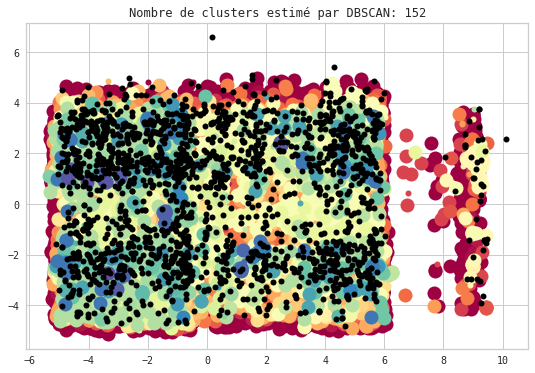

In [62]:
db = DBSCAN(eps=15, min_samples=5).fit(X_scaled)
labels = db.labels_
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X_scaled, labels))


unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = X_projected[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)

    xy = X_projected[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)

plt.title('Nombre de clusters estimé par DBSCAN: %d' % n_clusters_)
plt.show()

## e) Clustering avec K-prototype

### Application sur les données brutes Olist

> Cet algorithme permet d'effectuer le clustering sur des données mixtes à savoir numériques et catégorielles en utilisant la **mesure de la dissimilitude**.


* Information sur les colonnes du dataframe fusionné :

In [5]:
data_fusion.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119154 entries, 0 to 119153
Data columns (total 45 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       119151 non-null  object 
 1   customer_id                    119154 non-null  object 
 2   order_status                   119154 non-null  object 
 3   order_purchase_timestamp       119154 non-null  object 
 4   order_approved_at              118977 non-null  object 
 5   order_delivered_carrier_date   119154 non-null  object 
 6   order_delivered_customer_date  119154 non-null  object 
 7   order_estimated_delivery_date  119154 non-null  object 
 8   order_purchase_year            119154 non-null  float64
 9   order_purchase_month           119154 non-null  float64
 10  order_purchase_hour            119154 non-null  float64
 11  order_purchase_day             119154 non-null  object 
 12  order_purchase_time_day       

In [6]:
print('Nombre de lignes du fichier   : ', data_fusion.shape[0])
print('Nombre de colonnes du fichier : ', data_fusion.shape[1])

Nombre de lignes du fichier   :  119154
Nombre de colonnes du fichier :  45


> On va supprimer tous les champs suffixés **_id** qui ne sont pas nécessaires, ainsi que les données catégorielles ayant trop de valeurs uniques.

In [7]:
data_fusion.select_dtypes('object').nunique()

order_id                         99441
customer_id                      99443
order_status                        10
order_purchase_timestamp         98877
order_approved_at                90735
order_delivered_carrier_date     82801
order_delivered_customer_date    98628
order_estimated_delivery_date      461
order_purchase_day                  33
order_purchase_time_day              5
order_purchase_dayofweek             9
order_item_id                       23
product_id                       32953
seller_id                         3097
shipping_limit_date              93320
payment_type                         5
review_id                        99173
review_comment_title              3739
review_comment_message           36920
review_creation_date               637
review_answer_timestamp          99008
product_category_name               73
customer_unique_id               96094
customer_city                     4119
customer_state                      27
seller_city              

In [8]:
data_fusion.drop(columns=['order_id', 'customer_id',
                          'product_id', 'seller_id', 'review_id',
                          'review_comment_title', 
                          'review_comment_message',
                          'customer_unique_id', 'customer_city',
                          'seller_city',
                          'order_purchase_timestamp',
                          'order_approved_at',
                          'order_delivered_carrier_date',
                          'order_delivered_customer_date',
                          'order_estimated_delivery_date',
                          'shipping_limit_date',
                          'review_creation_date',
                          'review_answer_timestamp'],
                           inplace=True)

data_fusion.select_dtypes('object').nunique()

order_status                10
order_purchase_day          33
order_purchase_time_day      5
order_purchase_dayofweek     9
order_item_id               23
payment_type                 5
product_category_name       73
customer_state              27
seller_state                23
dtype: int64

* Types de variable présents :

In [9]:
data_fusion.dtypes.value_counts()

float64    18
object      9
dtype: int64

> <font color='red'> Il y a 9 variables catégorielles et 18 numériques.</font>

* Pourcentage de cellules vides :

In [10]:
nb_col_nan = data_fusion.isnull().sum()
nb_tot_cells_df = np.product(data_fusion.shape)
nb_tot_cells_manq = nb_col_nan.sum()

pct = (nb_tot_cells_manq / nb_tot_cells_df) * 100
print('Pourcentage de cellules manquantes   : ', pct)

Pourcentage de cellules manquantes   :  0.5548375305160642


> On va supprimer les cellules vides du dataframe.

In [11]:
data_fusion.dropna(inplace=True)

In [12]:
data_fusion.head()

,order_status,order_purchase_year,order_purchase_month,order_purchase_hour,order_purchase_day,order_purchase_time_day,order_purchase_dayofweek,order_item_id,price,freight_value,...,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_zip_code_prefix,customer_state,seller_zip_code_prefix,seller_state
0,delivered,2017.0,10.0,10.0,2,Morning,Mon,1.0,29.99,8.72,...,268.0,4.0,500.0,19.0,8.0,13.0,3149.0,SP,9350.0,SP
1,delivered,2017.0,10.0,10.0,2,Morning,Mon,1.0,29.99,8.72,...,268.0,4.0,500.0,19.0,8.0,13.0,3149.0,SP,9350.0,SP
2,delivered,2017.0,10.0,10.0,2,Morning,Mon,1.0,29.99,8.72,...,268.0,4.0,500.0,19.0,8.0,13.0,3149.0,SP,9350.0,SP
3,delivered,2017.0,8.0,18.0,15,Afternoon,Tue,1.0,29.99,7.78,...,268.0,4.0,500.0,19.0,8.0,13.0,3366.0,SP,9350.0,SP
4,delivered,2017.0,8.0,18.0,2,Afternoon,Wed,1.0,29.99,7.78,...,268.0,4.0,500.0,19.0,8.0,13.0,2290.0,SP,9350.0,SP


> On peut localiser la position des colonnes catégorielles dans le dataframe.

In [13]:
catColumnsPos = [data_fusion.columns.get_loc(col)\
                 for col in list(data_fusion.select_dtypes('object').columns)]
print('Colonnes catégorielles           : {}'\
      .format(list(data_fusion.select_dtypes('object').columns)))
print('Position des colonnes catégorielles  : {}'\
      .format(catColumnsPos))

Colonnes catégorielles           : ['order_status', 'order_purchase_day', 'order_purchase_time_day', 'order_purchase_dayofweek', 'order_item_id', 'payment_type', 'product_category_name', 'customer_state', 'seller_state']
Position des colonnes catégorielles  : [0, 4, 5, 6, 7, 11, 15, 24, 26]


* Transformation du dataframe en matrice :

In [14]:
X = data_fusion.to_numpy()
X

array([['delivered', 2017.0, 10.0, ..., 'SP', 9350.0, 'SP'],
       ['delivered', 2017.0, 10.0, ..., 'SP', 9350.0, 'SP'],
       ['delivered', 2017.0, 10.0, ..., 'SP', 9350.0, 'SP'],
       ...,
       ['delivered', 2018.0, 7.0, ..., 'CE', 13478.0, 'SP'],
       ['delivered', 2018.0, 5.0, ..., 'MG', 8320.0, 'SP'],
       ['delivered', 2018.0, 5.0, ..., 'SP', 14092.0, 'SP']], dtype=object)

* Utilisation de **la méthode du coude** avec **KPrototypes** afin de déterminer le nombre optimal de cluster k :


> On mesure le coût du cluster qui correspond à la somme des distances entre les points du cluster et le centroide.

In [15]:
from kmodes.kprototypes import KPrototypes
from sklearn.model_selection import cross_val_score
from lightgbm import LGBMClassifier
import shap

In [ ]:
plt.rcParams["figure.figsize"] = (9,6)

cost = []
for k in range(4, 12):
    model = KPrototypes(n_jobs=-1, n_clusters=k,
                        init='Huang', random_state=0)
    
    model.fit_predict(X, categorical=catColumnsPos)
    cost.append(model.cost_)
    


* Affichage du coût des clusters en fonction du nombre de clusters :

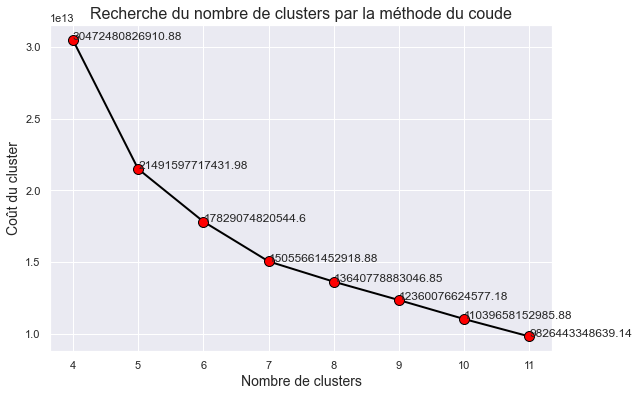

In [35]:
plt.plot(range(4, 12), cost, color='black',
         linestyle='solid', linewidth=2,
         markerfacecolor='red', markersize=10,
         marker='o')

plt.title('Recherche du nombre de clusters par la méthode du coude',
          fontsize=16)
plt.ylabel('Coût du cluster', fontsize=14)
plt.xlabel('Nombre de clusters', fontsize=14)

plt.text(4, round(cost[0], 2) + 0.2,
         str(round(cost[0], 2)), fontsize=12)
plt.text(5, round(cost[1], 2) + 0.2,
         str(round(cost[1], 2)), fontsize=12)
plt.text(6, round(cost[2], 2) + 0.2,
         str(round(cost[2], 2)), fontsize=12)
plt.text(7, round(cost[3], 2) + 0.2,
         str(round(cost[3], 2)), fontsize=12)
plt.text(8, round(cost[4], 2) + 0.2,
         str(round(cost[4], 2)), fontsize=12)
plt.text(9, round(cost[5], 2) + 0.2,
         str(round(cost[5], 2)), fontsize=12)
plt.text(10, round(cost[6], 2) + 0.2,
         str(round(cost[6], 2)), fontsize=12)
plt.text(11, round(cost[7], 2) + 0.2,
         str(round(cost[7], 2)), fontsize=12)


plt.show()

* Entrainement du modèle avec le bon choix **k=7** ou se trouve le coude :

In [17]:
model = KPrototypes(n_jobs= -1, n_clusters=7,
                    init='Huang', random_state=0)

model.fit_predict(X, categorical=catColumnsPos)

model.cluster_centroids_
model.n_iter_
model.cost_
clusters = model.labels_

In [18]:
print('Coût du clustering : ', model.cost_)

Coût du clustering :  15055661452918.885


* Interpétabilité du modèle :

In [19]:
data_fu_cluster = data_fusion.copy()

data_fu_cluster['Cluster Labels'] = clusters
data_fu_cluster['Segment'] = data_fu_cluster['Cluster Labels']\
                             .map({0:'Cluster 1', 1:'Cluster 2',
                                   2:'Cluster 3', 3:'Cluster 4',
                                   4:'Cluster 5', 5:'Cluster 6',
                                   6:'Cluster 7'})

data_fu_cluster['Segment'] = data_fu_cluster['Segment']\
                                .astype('category')
data_fu_cluster['Segment'] = data_fu_cluster['Segment']\
                        .cat.reorder_categories(['Cluster 1',
                                                 'Cluster 2',
                                                 'Cluster 3',
                                                 'Cluster 4',
                                                 'Cluster 5',
                                                 'Cluster 6',
                                                 'Cluster 7'])

data_fu_cluster.rename(columns = {'Cluster Labels':'Total'},
                   inplace = True)

data_fu_cluster

,order_status,order_purchase_year,order_purchase_month,order_purchase_hour,order_purchase_day,order_purchase_time_day,order_purchase_dayofweek,order_item_id,price,freight_value,...,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_zip_code_prefix,customer_state,seller_zip_code_prefix,seller_state,Total,Segment
0,delivered,2017.0,10.0,10.0,2,Morning,Mon,1.0,29.99,8.72,...,500.0,19.0,8.0,13.0,3149.0,SP,9350.0,SP,2,Cluster 3
1,delivered,2017.0,10.0,10.0,2,Morning,Mon,1.0,29.99,8.72,...,500.0,19.0,8.0,13.0,3149.0,SP,9350.0,SP,2,Cluster 3
2,delivered,2017.0,10.0,10.0,2,Morning,Mon,1.0,29.99,8.72,...,500.0,19.0,8.0,13.0,3149.0,SP,9350.0,SP,2,Cluster 3
3,delivered,2017.0,8.0,18.0,15,Afternoon,Tue,1.0,29.99,7.78,...,500.0,19.0,8.0,13.0,3366.0,SP,9350.0,SP,2,Cluster 3
4,delivered,2017.0,8.0,18.0,2,Afternoon,Wed,1.0,29.99,7.78,...,500.0,19.0,8.0,13.0,2290.0,SP,9350.0,SP,2,Cluster 3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119149,delivered,2018.0,7.0,10.0,1,Morning,Sun,1.0,79.00,14.13,...,750.0,30.0,28.0,28.0,8528.0,SP,13660.0,SP,2,Cluster 3
119150,canceled,2017.0,3.0,19.0,11,Night,Sat,1.0,19.70,10.96,...,400.0,16.0,4.0,11.0,89111.0,SC,89031.0,SC,6,Cluster 7
119151,delivered,2018.0,7.0,9.0,24,Morning,Tue,1.0,399.00,45.07,...,2100.0,80.0,8.0,30.0,60455.0,CE,13478.0,SP,3,Cluster 4
119152,delivered,2018.0,5.0,21.0,22,Night,Tue,1.0,219.90,24.12,...,5900.0,41.0,21.0,41.0,39803.0,MG,8320.0,SP,1,Cluster 2


In [20]:
data_fu_clu = data_fu_cluster.groupby('Segment')\
              .agg(payment_value_mean=('payment_value', 'mean'),
                   review_score_mode=('review_score',
                                      lambda x: x.value_counts().index[0]),
                   price_mean=('price', 'mean'),
                   order_status_mode=('order_status',
                                  lambda x: x.value_counts().index[0]),
                   pay_inst_mode=('payment_installments',
                                  lambda x: x.value_counts().index[0]),
                   purchase_time_day=('order_purchase_time_day',
                                  lambda x: x.value_counts().index[0]),
                   purchase_dayofweek=('order_purchase_dayofweek',
                                  lambda x: x.value_counts().index[0]),
                   product_category_name=('product_category_name',
                                  lambda x: x.value_counts().index[0]),
                   customer_state=('customer_state',
                                       lambda x: x.value_counts().index[0]),
                   seller_state_mode=('seller_state',
                                         lambda x: x.value_counts().index[0]),
                   ord_purch_year_mode=('order_purchase_year',
                                        lambda x: x.value_counts().index[0]),
                   ord_purch_month_mode=('order_purchase_month',
                                         lambda x: x.value_counts().index[0]),
                   Total=('order_purchase_year', 'count'))

data_fu_clu

,payment_value_mean,review_score_mode,price_mean,order_status_mode,pay_inst_mode,purchase_time_day,purchase_dayofweek,product_category_name,customer_state,seller_state_mode,ord_purch_year_mode,ord_purch_month_mode,Total
Segment,,,,,,,,,,,,,
Cluster 1,196.844499,5.0,143.537914,delivered,1.0,Afternoon,Mon,informatica acessorios,SP,PR,2018.0,7.0,11831
Cluster 2,168.232581,5.0,113.814975,delivered,1.0,Afternoon,Tue,cama mesa banho,RJ,SP,2018.0,5.0,23953
Cluster 3,144.042377,5.0,101.681568,delivered,1.0,Afternoon,Tue,cama mesa banho,SP,SP,2018.0,8.0,38412
Cluster 4,205.722824,5.0,139.467668,delivered,1.0,Afternoon,Mon,beleza saude,DF,SP,2018.0,7.0,10932
Cluster 5,179.523710,5.0,119.278593,delivered,1.0,Afternoon,Wed,cama mesa banho,RS,SP,2018.0,5.0,15441
Cluster 6,191.282884,5.0,143.420538,delivered,1.0,Afternoon,Tue,informatica acessorios,SP,MG,2017.0,8.0,9626
Cluster 7,219.829522,5.0,156.642450,delivered,1.0,Afternoon,Mon,informatica acessorios,RS,PR,2018.0,8.0,6407


> <font color='red'>ANALYSE</font>

> <font color='red'> Ce tableau synthétise les caractéristiques des 7 types de clients. **Le cluser 3** des clients les plus nombreux commandent sur le site Olist l'après-midi, souvent le mardi et habitent dans l'état de Sao Paulo, pour un montant moyen de 144 Real. Le matériel informatique est le produit le plus plébiscité par différents types de client.</font>

> La librairie **SHAP (SHapley Additive exPlanation)** permet de visualiser les clusters et les interpréter localement.

In [23]:
data_clu = data_fusion.copy()
for c in data_clu.select_dtypes(include='object'):
    data_clu[c] = data_clu[c].astype('category')


model = LGBMClassifier(subsample=1, colsample_by_tree=1,
                       colsample_bylevel=1)

In [24]:
cv_scores_kp = cross_val_score(model, data_clu, clusters,
                               scoring='f1_weighted')
print(f'CV F1 score pour les clusters K-Prototypes est {np.mean(cv_scores_kp)}')    

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel
CV F1 score pour les clusters K-Prototypes est 0.9937040934653378


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] Unknown parameter: colsample_bylevel


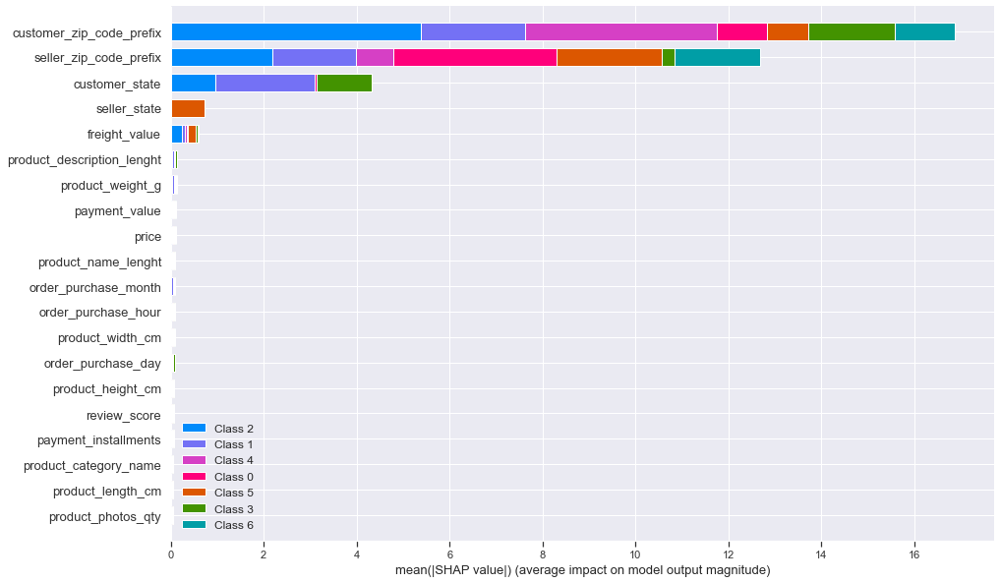

In [25]:
model.fit(data_clu, clusters)
explainer_kp = shap.TreeExplainer(model)
shap_values_kp = explainer_kp.shap_values(data_clu)
shap.summary_plot(shap_values_kp, data_clu, plot_type="bar",
                  plot_size=(15, 10))

> <font color='red'>ANALYSE</font>

> <font color='red'> Pour classifier les 7 clusters K-prototype, LightGBM a besoin de 5 variables dont 3 avec une plus grande importance. Les 2 variables catégorielles **customer_state et celler_state** ont une importance dans la définition des clusters.
La performance mesurée par le **F1 score** proche de 1, indique que les clusters sont bien définis.</font>